<img src="https://github.com/hernancontigiani/ceia_memorias_especializacion/raw/master/Figures/logoFIUBA.jpg" width="500" align="center">


# Procesamiento de lenguaje natural
## Predicción de próxima palabra

### Objetivo
El objetivo es utilizar documentos / corpus para crear embeddings de palabras basado en ese contexto utilizando la layer Embedding de Keras. Se utilizará esos embeddings junto con layers LSTM para predeccir la próxima posible palabra.

In [2]:
import random
import io
import pickle

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import torch
import torch.nn.functional as F
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader

In [3]:
cuda = torch.cuda.is_available()
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

In [4]:
# torchsummar actualmente tiene un problema con las LSTM, por eso
# se utiliza torchinfo, un fork del proyecto original con el bug solucionado
!pip3 install torchinfo
from torchinfo import summary

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [5]:
import os
import platform

if os.access('torch_helpers.py', os.F_OK) is False:
    if platform.system() == 'Windows':
        !curl !wget https://raw.githubusercontent.com/FIUBA-Posgrado-Inteligencia-Artificial/procesamiento_lenguaje_natural/main/scripts/torch_helpers.py > torch_helpers.py
    else:
        !wget torch_helpers.py https://raw.githubusercontent.com/FIUBA-Posgrado-Inteligencia-Artificial/procesamiento_lenguaje_natural/main/scripts/torch_helpers.py

In [6]:
from torch_helpers import categorical_acc

def train(model, train_loader, valid_loader, optimizer, criterion, epochs=100):
    # Defino listas para realizar graficas de los resultados
    train_loss = []
    train_accuracy = []
    valid_loss = []
    valid_accuracy = []

    # Defino mi loop de entrenamiento

    for epoch in range(epochs):

        epoch_train_loss = 0.0
        epoch_train_accuracy = 0.0

        for train_data, train_target in train_loader:
            # Seteo los gradientes en cero ya que, por defecto, PyTorch
            # los va acumulando
            optimizer.zero_grad()

            output = model(train_data.to(device)).cpu()

            # Computo el error de la salida comparando contra las etiquetas
            loss = criterion(output, train_target)

            # Almaceno el error del batch para luego tener el error promedio de la epoca
            epoch_train_loss += loss.item()

            # Computo el nuevo set de gradientes a lo largo de toda la red
            loss.backward()

            # Realizo el paso de optimizacion actualizando los parametros de toda la red
            optimizer.step()

            # Calculo el accuracy del batch
            accuracy = categorical_acc(output, train_target)
            # Almaceno el accuracy del batch para luego tener el accuracy promedio de la epoca
            epoch_train_accuracy += accuracy.item()

        # Calculo la media de error para la epoca de entrenamiento.
        # La longitud de train_loader es igual a la cantidad de batches dentro de una epoca.
        epoch_train_loss = epoch_train_loss / len(train_loader)
        train_loss.append(epoch_train_loss)
        epoch_train_accuracy = epoch_train_accuracy / len(train_loader)        
        train_accuracy.append(epoch_train_accuracy)

        # Realizo el paso de validación computando error y accuracy, y
        # almacenando los valores para imprimirlos y graficarlos
        valid_data, valid_target = iter(valid_loader).next()
        output = model(valid_data.to(device)).cpu()
        
        epoch_valid_loss = criterion(output, valid_target).item()
        valid_loss.append(epoch_valid_loss)

        # Calculo el accuracy de la epoch
        epoch_valid_accuracy = categorical_acc(output, valid_target).item()
        valid_accuracy.append(epoch_valid_accuracy)

        print(f"Epoch: {epoch+1}/{epochs} - Train loss {epoch_train_loss:.3f} - Train accuracy {epoch_train_accuracy:.3f} - Valid Loss {epoch_valid_loss:.3f} - Valid accuracy {epoch_valid_accuracy:.3f}")

    history = {
        "loss": train_loss,
        "accuracy": train_accuracy,
        "val_loss": valid_loss,
        "val_accuracy": valid_accuracy,
    }
    return history

### Datos
Utilizaremos como dataset canciones de bandas de habla inglés.

In [7]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [8]:
import os
os.listdir('/content/gdrive/MyDrive/CEIA/TPS/NLP/dickens')

['564-0.txt',
 '644-0.txt',
 '580-0.txt',
 '766-0.txt',
 '653-0.txt',
 '27924-0.txt',
 '675-0.txt',
 '678-0.txt',
 '1400-0.txt',
 '700-0.txt',
 '1289-0.txt',
 '1467-0.txt',
 '650-0.txt',
 '917-0.txt',
 '914-0.txt',
 '883-0.txt',
 '882-0.txt',
 '963-0.txt',
 '807-0.txt',
 '786-0.txt',
 '924-0.txt',
 'pg19337.txt',
 'pg32241.txt',
 'pg730.txt',
 '967-0.txt',
 'pg1392.txt',
 'pg1407.txt',
 'pg676.txt',
 'pg699.txt',
 'metadata.tsv',
 '98-0.txt',
 'pg1023.txt',
 'pg23344.txt']

In [9]:
path = '/content/gdrive/MyDrive/CEIA/TPS/NLP/dickens/'
dfs = list()
for file in os.listdir(path):
  df = pd.read_csv(path + file, sep='/n', header=None)
  dfs.append(df)
df = pd.concat(dfs)
df.shape

/usr/local/lib/python3.7/dist-packages/pandas/util/_decorators.py:311: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  return func(*args, **kwargs)


(387373, 1)

In [10]:
df.head()

,0
0,"The Project Gutenberg eBook, The Mystery of Ed..."
1,"Dickens, Illustrated by Luke Fildes"
2,This eBook is for the use of anyone anywhere a...
3,almost no restrictions whatsoever. You may co...
4,re-use it under the terms of the Project Guten...


In [11]:
print("Cantidad de documentos:", df.shape[0])

Cantidad de documentos: 387373


### 1 - Ejemplo de Preprocesamiento
- Hay que transformar las oraciones en tokens.
- Dichas oraciones hay que ajustarlas al tamaño fijo de nuestra sentencia de entrada al modelo.
- Hay que separar las palabras objetivos (target) que el modelo debe predecir en cada sentencia armada.

In [12]:
from torch_helpers import Tokenizer # tool de keras equivalente a ltokenizer de nltk
from torch_helpers import text_to_word_sequence # tool de keras equivalente a word_teokenize de nltk
from torch_helpers import pad_sequences # tool de keras qye se utilizará para padding

# largo de la secuencia, incluye seq input + word output
train_len = 5

In [13]:
df = df.reset_index()

### 2 - Preprocesamiento completo
Debemos realizar los mismos pasos que en el ejemplo anterior, pero antes de eso debemos transformar ese dataset de filas de oraciones en un texto completo continuo para poder extraer el vocabulario.

In [14]:
# Vistazo a las primeras filas
df.loc[:15,0]

0     The Project Gutenberg eBook, The Mystery of Ed...
1                   Dickens, Illustrated by Luke Fildes
2     This eBook is for the use of anyone anywhere a...
3     almost no restrictions whatsoever.  You may co...
4     re-use it under the terms of the Project Guten...
5        with this eBook or online at www.gutenberg.org
6                     Title: The Mystery of Edwin Drood
7                               Author: Charles Dickens
8         Release Date: December 25, 2010  [eBook #564]
9        [This file was first posted on April 15, 1996]
10                                    Language: English
11                        Character set encoding: UTF-8
12    ***START OF THE PROJECT GUTENBERG EBOOK THE MY...
13    Transcribed from the Chapman and Hall, 1914 ed...
14                                     ccx074@pglaf.org
15                           THE MYSTERY OF EDWIN DROOD
Name: 0, dtype: object

In [15]:
# Concatenamos todos los rows en un solo valor
corpus = df.apply(lambda row: ' '.join(row.values.astype(str)), axis=0)[0]
corpus

'The Project Gutenberg eBook, The Mystery of Edwin Drood, by Charles Dickens, Illustrated by Luke Fildes This eBook is for the use of anyone anywhere at no cost and with almost no restrictions whatsoever.  You may copy it, give it away or re-use it under the terms of the Project Gutenberg License included with this eBook or online at www.gutenberg.org Title: The Mystery of Edwin Drood Author: Charles Dickens Release Date: December 25, 2010  [eBook #564] [This file was first posted on April 15, 1996] Language: English Character set encoding: UTF-8 ***START OF THE PROJECT GUTENBERG EBOOK THE MYSTERY OF EDWIN DROOD*** Transcribed from the Chapman and Hall, 1914 edition by David Price, email ccx074@pglaf.org THE MYSTERY OF EDWIN DROOD [Picture: Rochester castle] CHAPTER I—THE DAWN An ancient English Cathedral Tower?  How can the ancient English Cathedral tower be here!  The well-known massive gray square tower of its old Cathedral?  How can that be here!  There is no spike of rusty iron in

In [16]:
# Transformar el corpus a tokens
tokens = text_to_word_sequence(corpus)
# Vistazo general de los primeros tokens
tokens[:20]

['the',
 'project',
 'gutenberg',
 'ebook',
 'the',
 'mystery',
 'of',
 'edwin',
 'drood',
 'by',
 'charles',
 'dickens',
 'illustrated',
 'by',
 'luke',
 'fildes',
 'this',
 'ebook',
 'is',
 'for']

In [17]:
print("Cantidad de tokens en el corpus:", len(tokens))

Cantidad de tokens en el corpus: 4453664


In [18]:
# Código para hacer el desfazaje de las palabras
# según el train_len
text_sequences = []
for i in range(train_len, len(tokens)):
  seq = tokens[i-train_len:i]
  text_sequences.append(seq)

In [19]:
# Demos un vistazo a nuestros vectores para entrenar el modelo
text_sequences[:20]

[['the', 'project', 'gutenberg', 'ebook', 'the'],
 ['project', 'gutenberg', 'ebook', 'the', 'mystery'],
 ['gutenberg', 'ebook', 'the', 'mystery', 'of'],
 ['ebook', 'the', 'mystery', 'of', 'edwin'],
 ['the', 'mystery', 'of', 'edwin', 'drood'],
 ['mystery', 'of', 'edwin', 'drood', 'by'],
 ['of', 'edwin', 'drood', 'by', 'charles'],
 ['edwin', 'drood', 'by', 'charles', 'dickens'],
 ['drood', 'by', 'charles', 'dickens', 'illustrated'],
 ['by', 'charles', 'dickens', 'illustrated', 'by'],
 ['charles', 'dickens', 'illustrated', 'by', 'luke'],
 ['dickens', 'illustrated', 'by', 'luke', 'fildes'],
 ['illustrated', 'by', 'luke', 'fildes', 'this'],
 ['by', 'luke', 'fildes', 'this', 'ebook'],
 ['luke', 'fildes', 'this', 'ebook', 'is'],
 ['fildes', 'this', 'ebook', 'is', 'for'],
 ['this', 'ebook', 'is', 'for', 'the'],
 ['ebook', 'is', 'for', 'the', 'use'],
 ['is', 'for', 'the', 'use', 'of'],
 ['for', 'the', 'use', 'of', 'anyone']]

In [20]:
# Proceso de tokenizacion
tok = Tokenizer() 
tok.fit_on_texts(text_sequences) 

# Convertimos las palabras a números
# entran palabras -> salen números
sequences = tok.texts_to_sequences(text_sequences)

# Damos un vistazo
sequences[:20]

[[1, 189, 179, 1256, 1],
 [189, 179, 1256, 1, 1909],
 [179, 1256, 1, 1909, 3],
 [1256, 1, 1909, 3, 2676],
 [1, 1909, 3, 2676, 4595],
 [1909, 3, 2676, 4595, 33],
 [3, 2676, 4595, 33, 964],
 [2676, 4595, 33, 964, 2886],
 [4595, 33, 964, 2886, 8268],
 [33, 964, 2886, 8268, 33],
 [964, 2886, 8268, 33, 19292],
 [2886, 8268, 33, 19292, 34763],
 [8268, 33, 19292, 34763, 32],
 [33, 19292, 34763, 32, 1256],
 [19292, 34763, 32, 1256, 25],
 [34763, 32, 1256, 25, 18],
 [32, 1256, 25, 18, 1],
 [1256, 25, 18, 1, 411],
 [25, 18, 1, 411, 3],
 [18, 1, 411, 3, 1714]]

In [21]:
print("Cantidad de rows del dataset:", len(sequences))

Cantidad de rows del dataset: 4453659


### 3 - Input y target

In [22]:
arr_sequences = np.array(sequences)
x_data = arr_sequences[:,:-1]
y_data_int = arr_sequences[:,-1] # aún falta el oneHotEncoder

print(x_data.shape)
print(y_data_int.shape)

(4453659, 4)
(4453659,)


In [23]:
# Palabras del vocabulario
tok.index_word

{1: 'the',
 2: 'and',
 3: 'of',
 4: 'to',
 5: 'a',
 6: 'in',
 7: 'i',
 8: '’',
 9: 'that',
 10: 'his',
 11: 'he',
 12: 'it',
 13: 'was',
 14: 'with',
 15: 'you',
 16: 'as',
 17: 'had',
 18: 'for',
 19: 'at',
 20: 'her',
 21: 'on',
 22: 'said',
 23: 'mr',
 24: 'my',
 25: 'is',
 26: 'be',
 27: 'him',
 28: 'have',
 29: 'not',
 30: 'but',
 31: 'me',
 32: 'this',
 33: 'by',
 34: 'she',
 35: 'so',
 36: 'all',
 37: 'which',
 38: 'or',
 39: 'were',
 40: 'they',
 41: 'from',
 42: 'if',
 43: 'when',
 44: 'no',
 45: 'there',
 46: 'one',
 47: 'out',
 48: 'been',
 49: 'very',
 50: 'an',
 51: 'who',
 52: 'up',
 53: 'would',
 54: 'upon',
 55: 'what',
 56: 'little',
 57: 'are',
 58: 'we',
 59: '”',
 60: 'into',
 61: 'do',
 62: 'them',
 63: 'their',
 64: 'man',
 65: 'your',
 66: 'more',
 67: 'old',
 68: 'some',
 69: 'any',
 70: 'time',
 71: 'could',
 72: 'sir',
 73: 'know',
 74: 'down',
 75: 'now',
 76: '‘i',
 77: 'will',
 78: 'mrs',
 79: 'about',
 80: 'then',
 81: 'than',
 82: 'again',
 83: 'like',
 8

In [24]:
# Cantidad de palabras en el vocabulario
vocab_size = len(tok.word_counts)
vocab_size

55524

In [25]:
# ¡Ojo! y_data_int comienza en "1" en vez de "0"
# valor minimo:
min(y_data_int)

1

In [26]:
# Hay que restar 1
y_data_int_offset = y_data_int - 1
min(y_data_int_offset)

0

In [ ]:
class Data(Dataset):
    def __init__(self, x, y):
        # Convertir los arrays de numpy a tensores. 
        # pytorch espera en general entradas 32bits
        self.x = torch.from_numpy(x.astype(np.int32))
        # Transformar los datos a oneHotEncoding
        # la loss function esperan la salida float
        self.y = F.one_hot(torch.from_numpy(y), num_classes=vocab_size).float()

        self.len = self.y.shape[0]

    def __getitem__(self,index):
        return self.x[index], self.y[index]

    def __len__(self):
        return self.len

data_set = Data(x_data, y_data_int_offset)

input_size = data_set.x.shape[1]
print("input_size:", input_size)

output_dim = data_set.y.shape[1]
print("Output dim", output_dim)

In [ ]:
torch.manual_seed(42)
valid_set_size = int(data_set.len * 0.2)
train_set_size = data_set.len - valid_set_size

train_set = torch.utils.data.Subset(data_set, range(train_set_size))
valid_set = torch.utils.data.Subset(data_set, range(train_set_size, data_set.len))

print("Tamaño del conjunto de entrenamiento:", len(train_set))
print("Tamaño del conjunto de validacion:", len(valid_set))

train_batch_size = 32
train_loader = torch.utils.data.DataLoader(train_set, batch_size=train_batch_size, shuffle=True)
valid_loader = torch.utils.data.DataLoader(valid_set, batch_size=len(valid_set), shuffle=False)

### 4 - Entrenar el modelo

In [ ]:
class Model1(nn.Module):
    def __init__(self, vocab_size, output_dim):
        super().__init__()
        # num_embeddings = vocab_size --> 1628 palabras distintas + 1 para padding o UNK
        # embedding_dim = 5 --> crear embeddings de tamaño 5 (tamaño variable y ajustable)
        self.lstm_size = 64
        self.num_layers = 2
        self.embedding = nn.Embedding(num_embeddings=vocab_size+1, embedding_dim=5, padding_idx=0)
        self.lstm1 = nn.LSTM(input_size=5, hidden_size=self.lstm_size, batch_first=True,
                            num_layers=self.num_layers, dropout=0.2) # LSTM layer
        self.fc1 = nn.Linear(in_features=self.lstm_size, out_features=32) # Fully connected layer
        self.fc2 = nn.Linear(in_features=32, out_features=output_dim) # Fully connected layer
        
        self.relu = nn.ReLU()
        self.softmax = nn.Softmax(dim=1) # normalize in dim 1

    def forward(self, x, prev_state=None):
        if prev_state is None:
            # En cada nueva inferencia reinicio el hidden state
            # de la LSTM al menos que sea pasado por parámetro el
            # elstado de previo
            # Esta acción se realiza especialmente para que
            # el hidden_state de la última inferencia no afecte
            # a la siguiente
            batch_size = x.shape[0] #(batch, seq_size)
            prev_state = self.init_hidden(batch_size)

        out = self.embedding(x)
        lstm_output, (ht, ct) = self.lstm1(out, prev_state)
        out = self.relu(self.fc1(lstm_output[:,-1,:])) # take last output (last seq)
        out = self.softmax(self.fc2(out))
        return out

    def init_hidden(self, batch_size):
        return (torch.zeros(self.num_layers, batch_size, self.lstm_size).to(device),
                torch.zeros(self.num_layers, batch_size, self.lstm_size).to(device))

model1 = Model1(vocab_size=vocab_size, output_dim=output_dim)
if cuda: model1.cuda()

# Crear el optimizador la una función de error
model1_optimizer = torch.optim.Adam(model1.parameters(), lr=0.001)
model1_criterion = torch.nn.CrossEntropyLoss()  # Para clasificación multi categórica

# Por defecto torchinfo testea el modelo con torch.FloatTensor
#summary(model1, input_size=(1, input_size), dtypes=['torch.IntTensor'], device=torch.device(device))

# otra posibilidad
summary(model1, input_data=data_set[0][0].unsqueeze(0))

Layer (type:depth-idx)                   Output Shape              Param #
Model1                                   [1, 1628]                 --
├─Embedding: 1-1                         [1, 3, 5]                 8,145
├─LSTM: 1-2                              [1, 3, 64]                51,456
├─Linear: 1-3                            [1, 32]                   2,080
├─ReLU: 1-4                              [1, 32]                   --
├─Linear: 1-5                            [1, 1628]                 53,724
├─Softmax: 1-6                           [1, 1628]                 --
Total params: 115,405
Trainable params: 115,405
Non-trainable params: 0
Total mult-adds (M): 0.22
Input size (MB): 0.00
Forward/backward pass size (MB): 0.01
Params size (MB): 0.46
Estimated Total Size (MB): 0.48

In [ ]:
history1 = train(model1,
                train_loader,
                valid_loader,
                model1_optimizer,
                model1_criterion,
                epochs=100
                )

Epoch: 1/100 - Train loss 7.356 - Train accuracy 0.046 - Valid Loss 7.356 - Valid accuracy 0.040
Epoch: 2/100 - Train loss 7.346 - Train accuracy 0.050 - Valid Loss 7.356 - Valid accuracy 0.040
Epoch: 3/100 - Train loss 7.346 - Train accuracy 0.050 - Valid Loss 7.356 - Valid accuracy 0.040
Epoch: 4/100 - Train loss 7.346 - Train accuracy 0.050 - Valid Loss 7.356 - Valid accuracy 0.040
Epoch: 5/100 - Train loss 7.346 - Train accuracy 0.050 - Valid Loss 7.356 - Valid accuracy 0.040
Epoch: 6/100 - Train loss 7.346 - Train accuracy 0.050 - Valid Loss 7.356 - Valid accuracy 0.040
Epoch: 7/100 - Train loss 7.346 - Train accuracy 0.050 - Valid Loss 7.356 - Valid accuracy 0.040
Epoch: 8/100 - Train loss 7.346 - Train accuracy 0.050 - Valid Loss 7.356 - Valid accuracy 0.040
Epoch: 9/100 - Train loss 7.346 - Train accuracy 0.050 - Valid Loss 7.356 - Valid accuracy 0.040
Epoch: 10/100 - Train loss 7.346 - Train accuracy 0.050 - Valid Loss 7.356 - Valid accuracy 0.040
Epoch: 11/100 - Train loss 7.

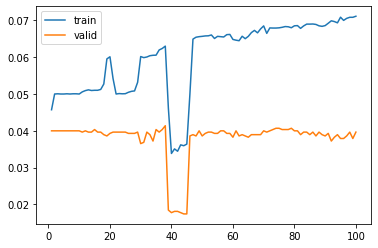

In [ ]:
epoch_count = range(1, len(history1['accuracy']) + 1)
sns.lineplot(x=epoch_count,  y=history1['accuracy'], label='train')
sns.lineplot(x=epoch_count,  y=history1['val_accuracy'], label='valid')
plt.show()

__Es importante__ destacar que en este ejemplo estamos entrenando nuestro propios Embeddings y para ello se requiere mucha data. En los ejemplos que realizaremos de aquí en más utilizaremos más datos, embeddings pre-enternados o modelos pre-entrenados.

### 5 - Predicción de próxima palabra

In [ ]:
# pad_sequences
# Si la secuencia de entrada supera al input_seq_len (3) se trunca
# Si la secuencia es más corta se agregna ceros al comienzo

In [ ]:
# Se utilizará gradio para ensayar el modelo
# Herramienta poderosa para crear interfaces rápidas para ensayar modelos
# https://gradio.app/
import sys
!{sys.executable} -m pip install gradio --quiet

     |████████████████████████████████| 5.1 MB 5.2 MB/s 
     |████████████████████████████████| 253 kB 74.6 MB/s 
     |████████████████████████████████| 2.0 MB 56.1 MB/s 
     |████████████████████████████████| 212 kB 61.7 MB/s 
     |████████████████████████████████| 53 kB 2.6 MB/s 
     |████████████████████████████████| 54 kB 3.7 MB/s 
     |████████████████████████████████| 1.1 MB 53.9 MB/s 
     |████████████████████████████████| 84 kB 4.1 MB/s 
     |████████████████████████████████| 144 kB 72.7 MB/s 
     |████████████████████████████████| 271 kB 64.7 MB/s 
     |████████████████████████████████| 94 kB 4.3 MB/s 
     |████████████████████████████████| 11.1 MB 58.7 MB/s 
     |████████████████████████████████| 63 kB 2.4 MB/s 
     |████████████████████████████████| 80 kB 11.8 MB/s 
     |████████████████████████████████| 43 kB 2.8 MB/s 
     |████████████████████████████████| 856 kB 68.0 MB/s 
     |████████████████████████████████| 4.0 MB 50.0 MB/s 
     |█████████████████████

In [ ]:
import gradio as gr

def model_response(human_text):

    # Encodeamos
    encoded = tok.texts_to_sequences([human_text])[0]
    # Si tienen distinto largo
    encoded = pad_sequences([encoded], maxlen=3, padding='pre')
    
    # Transformo a tensor
    tensor = torch.from_numpy(encoded.astype(np.int32))

    # Predicción softmax
    y_hat = model1(tensor).argmax(axis=-1)

    # Debemos buscar en el vocabulario la palabra
    # que corresopnde al indice (y_hat) predicho por le modelo
    out_word = ''
    for word, index in tok.word_index.items():
        if index == y_hat:
            out_word = word
            break

    # Agrego la palabra a la frase predicha
    return human_text + ' ' + out_word

iface = gr.Interface(
    fn=model_response,
    inputs=["textbox"],
    outputs="text",
    layout="vertical")

iface.launch(debug=True)

/usr/local/lib/python3.7/dist-packages/gradio/deprecation.py:40: UserWarning: `layout` parameter is deprecated, and it has no effect
  warnings.warn(value)


Colab notebook detected. This cell will run indefinitely so that you can see errors and logs. To turn off, set debug=False in launch().
Running on public URL: https://17280.gradio.app

This share link expires in 72 hours. For free permanent hosting, check out Spaces (https://huggingface.co/spaces)


Keyboard interruption in main thread... closing server.


(<gradio.routes.App at 0x7f68dd6cfe50>,
 'http://127.0.0.1:7860/',
 'https://17280.gradio.app')

### 6 - Generación de secuencias nuevas

In [ ]:
def generate_seq(model, tokenizer, seed_text, max_length, n_words):
    """
        Exec model sequence prediction

        Args:
            model (keras): modelo entrenado
            tokenizer (keras tokenizer): tonenizer utilizado en el preprocesamiento
            seed_text (string): texto de entrada (input_seq)
            max_length (int): máxima longitud de la sequencia de entrada
            n_words (int): números de palabras a agregar a la sequencia de entrada
        returns:
            output_text (string): sentencia con las "n_words" agregadas
    """
    output_text = seed_text
	# generate a fixed number of words
    for _ in range(n_words):
		# Encodeamos
        encoded = tokenizer.texts_to_sequences([output_text])[0]
		# Si tienen distinto largo
        encoded = pad_sequences([encoded], maxlen=max_length, padding='pre')
		
        # Transformo a tensor
        tensor = torch.from_numpy(encoded.astype(np.int32))

        # Predicción softmax
        y_hat = model1(tensor).argmax(axis=-1)

		# Vamos concatenando las predicciones
        out_word = ''

        # Debemos buscar en el vocabulario la palabra
        # que corresopnde al indice (y_hat) predicho por le modelo
        for word, index in tokenizer.word_index.items():
            if index == y_hat:
                out_word = word
                break

		# Agrego las palabras a la frase predicha
        output_text += ' ' + out_word
    return output_text

In [ ]:
input_text='hey jude don\'t'

generate_seq(model1, tok, input_text, max_length=3, n_words=2)

"hey jude don't you "

### 7 - Conclusiones
El modelo entrenado tuvo un muy mail desempeño en el entrenamiento además de overfitting. Cuestiones que podrían mejorarse:
- Agregar más capas o neuronaes
- Incrementar la cantidad de épocas
- Agregar BRNN

Es importante destacar que en este ejemplo estamos entrenando nuestro propios Embeddings, y para ello se requiere mucha data. En los ejemplos que realizaremos de aquí en más utilizaremos más datos, embeddings pre-enternados o modelos pre-entrenados.